<a href="https://colab.research.google.com/github/ArijeetRakshit/Gland_Identification/blob/main/glandIdentification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
!ls {'/content/gdrive/"My Drive"/COLON_DATASET'}

output_unet   test-20200814T152147Z-001
output_unet1  train-20200814T152324Z-001


In [ ]:
import os
import random
from time import time
import numpy as np
from skimage.transform import resize
from skimage.io import imread, imshow 
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.python.keras.callbacks import TensorBoard
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda
from keras.utils import normalize

In [ ]:
!pip install tensorboardcolab

  Created wheel for tensorboardcolab: filename=tensorboardcolab-0.0.22-cp37-none-any.whl size=3860 sha256=82f5a0ec9b04f393791f5ffc8f6cf01de978029d6aea225b202abe1c8580e697
  Stored in directory: /root/.cache/pip/wheels/c4/aa/a0/3aaf4f1a66adbdab9b7bdd4c96db8ada89eb7cd87200cfdd32
Successfully built tensorboardcolab


In [ ]:
image_height= 256
image_width= 256

data_path='/content/gdrive/My Drive/COLON_DATASET'

In [ ]:
def create_train_data():
  train_data_path=os.path.join(data_path,"train-20200814T152324Z-001/train")
  images=os.listdir(train_data_path)
  total=len(images)//2

  imgs=np.zeros((total,image_height,image_width,3),dtype=np.uint8)
  imgs_mask=np.zeros((total,image_height,image_width,1),dtype=np.bool)

  print("creating training images")
  i=0
  for img_name in images:
    if("anno" in img_name):
      continue

    img=imread(os.path.join(train_data_path,img_name))
    img=resize(img,(image_height,image_width),mode="constant",preserve_range=True)
 
    img_mask_name=img_name.split(".")[0] + "_anno.bmp"
    
    img_mask=imread(os.path.join(train_data_path,img_mask_name))
    img_mask=np.expand_dims(resize(img_mask,(image_height,image_width),mode="constant",preserve_range=True),axis=-1) 

    mask=np.zeros((image_height,image_width,1),dtype=np.bool) 
    img_mask=np.maximum(img_mask,mask) 
   
    imgs[i]=img
    imgs_mask[i]=img_mask
    
    print(i,"/",total,"read")
    i+=1

  
  np.save("imgs_train.npy",imgs)
  np.save("imgs_mask_train.npy",imgs_mask)
  print("done")

In [ ]:
def create_test_data():
  test_data_path=os.path.join(data_path,"test-20200814T152147Z-001/test")
  images=os.listdir(test_data_path)               
  total=len(images)//2

  imgs=np.zeros((total,image_height,image_width,3),dtype=np.uint8)
  imgs_mask=np.zeros((total,image_height,image_width,1),dtype=np.bool)

  print("creating test images")
  i=0
  for img_name in images:
    if("anno" in img_name):
      continue

    img=imread(os.path.join(test_data_path,img_name))
    img=resize(img,(image_height,image_width),mode="constant",preserve_range=True)

    img_mask_name=img_name.split(".")[0] + "_anno.bmp"
    
    img_mask=imread(os.path.join(test_data_path,img_mask_name))
    img_mask=np.expand_dims(resize(img_mask,(image_height,image_width),mode="constant",preserve_range=True),axis=-1)

    mask=np.zeros((image_height,image_width,1),dtype=np.bool) 
    img_mask=np.maximum(img_mask,mask)   
    
    imgs[i]=img
    imgs_mask[i]=img_mask
    
    print(i,"/",total,"read")
    i+=1
 
  #imgs = normalize(np.array(imgs), axis=1)
  np.save("imgs_test.npy",imgs)
  np.save("imgs_mask_test.npy",imgs_mask)
  print("done")

In [ ]:
def load_train_data():
  imgs_train=np.load("imgs_train.npy")
  imgs_mask_train=np.load("imgs_mask_train.npy")
  return imgs_train,imgs_mask_train

def load_test_data():
  imgs_test=np.load("imgs_test.npy")
  imgs_mask_test=np.load("imgs_mask_test.npy")
  return imgs_test,imgs_mask_test

create_train_data()
create_test_data()

creating training images
0 / 85 read
1 / 85 read
2 / 85 read
3 / 85 read
4 / 85 read
5 / 85 read
6 / 85 read
7 / 85 read
8 / 85 read
9 / 85 read
10 / 85 read
11 / 85 read
12 / 85 read
13 / 85 read
14 / 85 read
15 / 85 read
16 / 85 read
17 / 85 read
18 / 85 read
19 / 85 read
20 / 85 read
21 / 85 read
22 / 85 read
23 / 85 read
24 / 85 read
25 / 85 read
26 / 85 read
27 / 85 read
28 / 85 read
29 / 85 read
30 / 85 read
31 / 85 read
32 / 85 read
33 / 85 read
34 / 85 read
35 / 85 read
36 / 85 read
37 / 85 read
38 / 85 read
39 / 85 read
40 / 85 read
41 / 85 read
42 / 85 read
43 / 85 read
44 / 85 read
45 / 85 read
46 / 85 read
47 / 85 read
48 / 85 read
49 / 85 read
50 / 85 read
51 / 85 read
52 / 85 read
53 / 85 read
54 / 85 read
55 / 85 read
56 / 85 read
57 / 85 read
58 / 85 read
59 / 85 read
60 / 85 read
61 / 85 read
62 / 85 read
63 / 85 read
64 / 85 read
65 / 85 read
66 / 85 read
67 / 85 read
68 / 85 read
69 / 85 read
70 / 85 read
71 / 85 read
72 / 85 read
73 / 85 read
74 / 85 read
75 / 85 re

In [ ]:
def unet_model(image_height,image_width,img_channels):
    inputs = Input((image_height,image_width,img_channels))
    s = Lambda(lambda x: x / 255)(inputs)

    #Contraction path

    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s)
    c1 = Dropout(0.1)(c1)
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)
    
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = Dropout(0.1)(c2)
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)
     
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = Dropout(0.2)(c3)
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)
     
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    c4 = Dropout(0.2)(c4)
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    p4 = MaxPooling2D(pool_size=(2, 2))(c4)
     
    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
    c5 = Dropout(0.3)(c5)
    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)
    
    #Expanding path 
    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
    c6 = Dropout(0.2)(c6)
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)
     
    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
    c7 = Dropout(0.2)(c7)
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)
     
    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)
     
    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = Dropout(0.1)(c9)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)

     
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)
     
    model = Model(inputs=[inputs], outputs=[outputs])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    model.summary()
    
    return model

In [ ]:
unet_model(image_height,image_width,3)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
lambda (Lambda)                 (None, 256, 256, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 16) 448         lambda[0][0]                     
__________________________________________________________________________________________________
dropout (Dropout)               (None, 256, 256, 16) 0           conv2d[0][0]                     
______________________________________________________________________________________________

In [ ]:
def train_predict():

  stack=10 
  print("loading images")
  imgs_train,imgs_mask_train = load_train_data() # loading the train data images and its mask
  imgs_test,imgs_mask_test = load_test_data() # loading the test data images and its mask
  model=unet_model(image_height,image_width,3) # initialised the model

  print("data augumentation") # data augmentation by creating mutiple images from same images by changing postion,cropping, padding etc. of the image
  datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        rotation_range=15,
        width_shift_range=0.15,
        height_shift_range=0.15,
        shear_range=0.15,
        horizontal_flip=True,   
        vertical_flip=True)
        
  total = imgs_train.shape[0]
  
  img = []
  count = 0
  for batch in datagen.flow(imgs_train, batch_size=1, seed=1337):
      img.append(batch)
      count += 1
      if count > total*stack:
          break
  imgs_train = np.array(img)[:,0]

  mask = [] 
  count = 0
  for batch in datagen.flow(imgs_mask_train, batch_size=1, seed=1337): 
      mask.append(batch)
      count += 1
      if count > total*stack:
          break
  imgs_mask_train = np.array(mask)[:,0]

  tb=TensorBoard(log_dir='logs/{}'.format(time())) 
  callbacks=[ 

             tf.keras.callbacks.EarlyStopping(patience=5, monitor="val_loss", verbose=0), tb, # patience = 5 means training will stop if same accuracy is 
             # given by consecutive 5 epochs montior=val_loss means monitor the value of the valalidation loss  	                                                                            
             tf.keras.callbacks.ModelCheckpoint("weights.h5", monitor="loss", save_best_only=True) # stores the best weights and bias of 
             #each epoch in weights.h5 file.
   ]
  model.fit(imgs_train, imgs_mask_train,  
                    batch_size = stack, 
                    verbose=1, 
                    epochs=1000,  
                    shuffle=True, callbacks=callbacks, validation_split=0.1)  # sending input = imgs_train and output = imgs_mask_train, the model now try to generate 
                    # similar kind of output for corresponding input.
  
  _, acc = model.evaluate(imgs_test, imgs_mask_test) # evalute on test images and its corresponding mask.
  print("Accuracy = ", (acc * 100.0), "%") # measures the accuracy of the model
  
  

  predicted_imgs_mask_test=model.predict(imgs_test,verbose=1)     
  pred_test=(predicted_imgs_mask_test>0.5).astype(np.uint8) # if predicted_imgs_mask_test>0.5 , storing it in pred_test and values are converted to int
  np.save("predicted_imgs_mask_test.npy",pred_test) # saving pred_test in predicted_imgs_mask_test.npy file

  #IoU score
  intersection = np.logical_and(imgs_mask_test,pred_test)
  union = np.logical_or(imgs_mask_test,pred_test)
  iou_score = np.sum(intersection) / np.sum(union)
  print("IoU score is: ", iou_score)
  print("done") 

  # weights values
  model.load_weights("weights.h5") 
  for layer in model.layers:
    weights = layer.get_weights()
    print(weights)      

In [ ]:
train_predict()

loading images
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
lambda_3 (Lambda)               (None, 256, 256, 3)  0           input_4[0][0]                    
__________________________________________________________________________________________________
conv2d_57 (Conv2D)              (None, 256, 256, 16) 448         lambda_3[0][0]                   
__________________________________________________________________________________________________
dropout_27 (Dropout)            (None, 256, 256, 16) 0           conv2d_57[0][0]                  
_____________________________________________________________________________

In [ ]:
def graph():
  imgs=np.load("imgs_test.npy")
  imgs_mask=np.load("imgs_mask_test.npy")
  result=np.load("predicted_imgs_mask_test.npy")
  for i in range (20):
    plt.title(f'Image {i+1}')
    plt.imshow(imgs[i]) 
    plt.savefig(f'/content/gdrive/My Drive/COLON_DATASET/output_unet1/Image{i+1}.jpg') # figs are saved in folder output_unet1 inside COLON DATASET folder
    plt.show()

    plt.title(f'Original Image Mask {i+1}')
    plt.imshow(np.squeeze(imgs_mask[i])) 
    plt.savefig(f'/content/gdrive/My Drive/COLON_DATASET/output_unet1/Original_Image_Mask{i+1}.jpg') # figs are saved in folder output_unet1 inside COLON DATASET folder
    plt.show()

    plt.title(f'Predicted Image Mask {i+1}')
    plt.imshow(np.squeeze(result[i]))
    plt.savefig(f'/content/gdrive/My Drive/COLON_DATASET/output_unet1/Predicted_Image_Mask{i+1}.jpg') # figs are saved in folder output_unet1 inside COLON DATASET folder
    plt.show()

    plt.title(f'Segmented Image {i+1}')
    segmented_img = cv2.bitwise_and(imgs[i],imgs[i], mask = result[i]) # (imgs[i] bitwise_and imgs[i]), if result[i] != 0 
    plt.imshow(segmented_img)
    plt.savefig(f'/content/gdrive/My Drive/COLON_DATASET/output_unet1/Segmented_Image{i+1}.jpg')  # figs are saved in folder output_unet1 inside COLON DATASET folder
    plt.show()

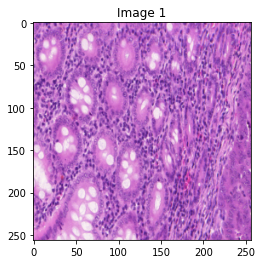

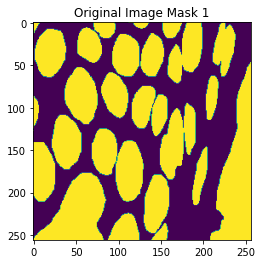

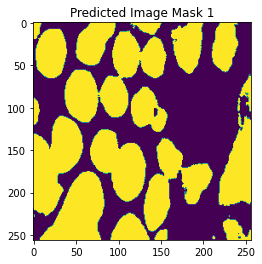

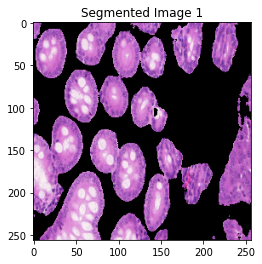

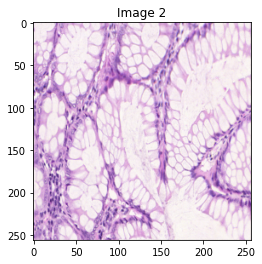

...

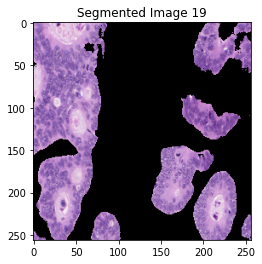

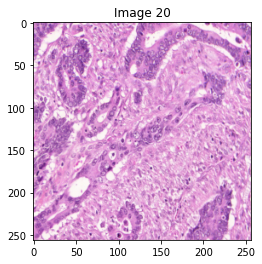

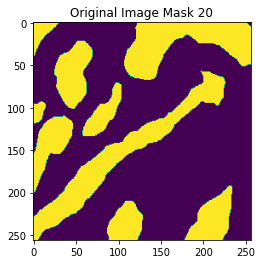

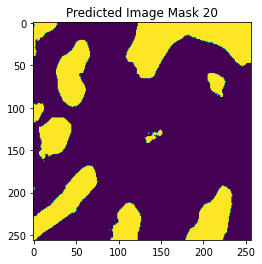

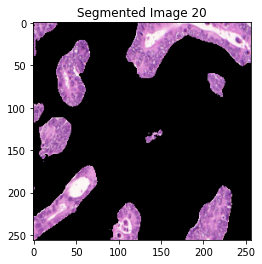

In [ ]:
graph()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>